In [1]:
import tensorflow as tf### models
import numpy as np### math computations
import matplotlib.pyplot as plt### plotting bar chart
import sklearn### machine learning library
import cv2## image processing
from sklearn.metrics import confusion_matrix, roc_curve### metrics
import seaborn as sns### visualizations
import datetime
import pathlib
import io
import os
import time
import random
from PIL import Image
import albumentations as A
import tensorflow_datasets as tfds
import tensorflow_probability as tfp
import matplotlib.cm as cm
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer
from tensorflow.keras.layers import (GlobalAveragePooling2D, Activation, MaxPooling2D, Add, Conv2D, MaxPool2D, Dense,
                                     Flatten, InputLayer, BatchNormalization, Input, Embedding, Permute,
                                     Dropout, RandomFlip, RandomRotation, LayerNormalization, MultiHeadAttention,
                                     RandomContrast, Rescaling, Resizing, Reshape)
from tensorflow.keras.losses import BinaryCrossentropy,CategoricalCrossentropy, SparseCategoricalCrossentropy
from tensorflow.keras.metrics import Accuracy,TopKCategoricalAccuracy, CategoricalAccuracy, SparseCategoricalAccuracy
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import (Callback, CSVLogger, EarlyStopping, LearningRateScheduler,
                                        ModelCheckpoint, ReduceLROnPlateau)
from tensorflow.keras.regularizers  import L2, L1
from tensorflow.train import BytesList, FloatList, Int64List
from tensorflow.train import Example, Features, Feature

/opt/conda/lib/python3.10/site-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.22 (you have 1.4.21). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [2]:
CONFIGURATION = {
    "BATCH_SIZE": 16,
    "IM_SIZE": 256,
    "LEARNING_RATE": 1e-3,
    "N_EPOCHS": 20,
    "DROPOUT_RATE": 0.2,
    "REGULARIZATION_RATE": 0.001,
    "N_FILTERS": 6,
    "KERNEL_SIZE": 3,
    "N_STRIDES": 1,
    "POOL_SIZE": 2,
    "N_DENSE_1": 1024,
    "N_DENSE_2": 512,
    "NUM_CLASSES": 3,
    "PATCH_SIZE": 16,
    "PROJ_DIM": 768,
    "CLASS_NAMES": ["angry", "happy", "sad"],
}

In [3]:
train_directory = "/kaggle/input/human-emotions-datasethes/Emotions Dataset/Emotions Dataset/train"
val_directory = "/kaggle/input/human-emotions-datasethes/Emotions Dataset/Emotions Dataset/test"

## Dataset Loading

In [4]:
train_dataset = tf.keras.utils.image_dataset_from_directory(
    train_directory,
    labels='inferred',
    label_mode='categorical',
    class_names=CONFIGURATION["CLASS_NAMES"],
    color_mode='rgb',
    batch_size=CONFIGURATION["BATCH_SIZE"],
    image_size=(CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"]),
    shuffle=True,
    seed=99,
)

Found 6799 files belonging to 3 classes.


In [5]:
val_dataset = tf.keras.utils.image_dataset_from_directory(
    val_directory,
    labels='inferred',
    label_mode='categorical',
    class_names=CONFIGURATION["CLASS_NAMES"],
    color_mode='rgb',
    batch_size=1,#CONFIGURATION["BATCH_SIZE"],
    image_size=(CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"]),
    shuffle=True,
    seed=99,
)

Found 2278 files belonging to 3 classes.


## for checking the label_mode like how it outputs while in int,categorical modes

In [6]:
# for i in val_dataset.take(1):
#   print(i)

## Dataset Visualization

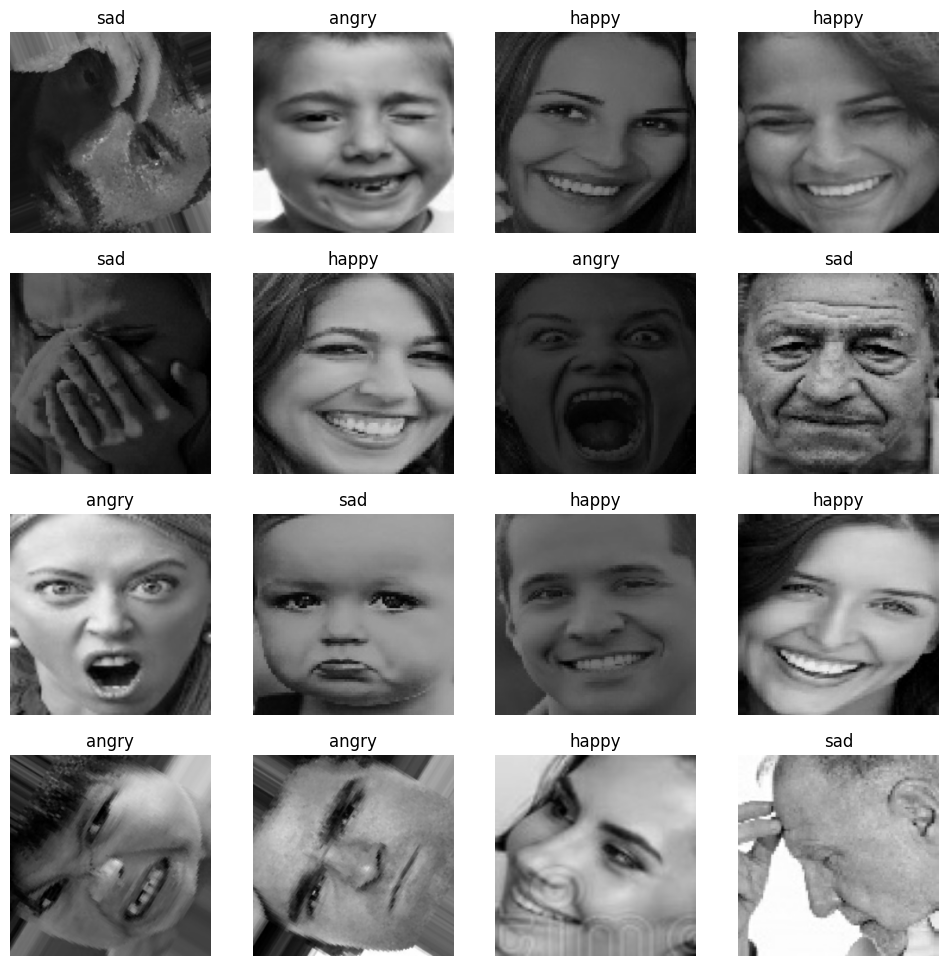

In [6]:
plt.figure(figsize = (12,12))

for images, labels in train_dataset.take(1):
  for i in range(16):
    ax = plt.subplot(4,4, i+1)
    plt.imshow(images[i]/255.)
    plt.title(CONFIGURATION["CLASS_NAMES"][tf.argmax(labels[i], axis = 0).numpy()])
    plt.axis("off")

## Data Augmentation

In [7]:
### tf.keras.layer augment
augment_layers = tf.keras.Sequential([
  RandomRotation(factor = (-0.025, 0.025)),
  RandomFlip(mode='horizontal',),
  RandomContrast(factor=0.1),
])

In [8]:
def augment_layer(image, label):
  return augment_layers(image, training = True), label

### Cutmix Augmentation

In [9]:
def box(lamda):

  r_x = tf.cast(tfp.distributions.Uniform(0, CONFIGURATION["IM_SIZE"]).sample(1)[0], dtype = tf.int32)
  r_y = tf.cast(tfp.distributions.Uniform(0, CONFIGURATION["IM_SIZE"]).sample(1)[0], dtype = tf.int32)

  r_w = tf.cast(CONFIGURATION["IM_SIZE"]*tf.math.sqrt(1-lamda), dtype = tf.int32)
  r_h = tf.cast(CONFIGURATION["IM_SIZE"]*tf.math.sqrt(1-lamda), dtype = tf.int32)

  r_x = tf.clip_by_value(r_x - r_w//2, 0, CONFIGURATION["IM_SIZE"])
  r_y = tf.clip_by_value(r_y - r_h//2, 0, CONFIGURATION["IM_SIZE"])

  x_b_r = tf.clip_by_value(r_x + r_w//2, 0, CONFIGURATION["IM_SIZE"])
  y_b_r = tf.clip_by_value(r_y + r_h//2, 0, CONFIGURATION["IM_SIZE"])

  r_w = x_b_r - r_x
  if(r_w == 0):
    r_w  = 1

  r_h = y_b_r - r_y
  if(r_h == 0):
    r_h = 1

  return r_y, r_x, r_h, r_w

In [10]:
def cutmix(train_dataset_1, train_dataset_2):
  (image_1,label_1), (image_2, label_2) = train_dataset_1, train_dataset_2

  lamda = tfp.distributions.Beta(2,2)
  lamda = lamda.sample(1)[0]

  r_y, r_x, r_h, r_w = box(lamda)
  crop_2 = tf.image.crop_to_bounding_box(image_2, r_y, r_x, r_h, r_w)
  pad_2 = tf.image.pad_to_bounding_box(crop_2, r_y, r_x, CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"])

  crop_1 = tf.image.crop_to_bounding_box(image_1, r_y, r_x, r_h, r_w)
  pad_1 = tf.image.pad_to_bounding_box(crop_1, r_y, r_x, CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"])

  image = image_1 - pad_1 + pad_2

  lamda = tf.cast(1- (r_w*r_h)/(CONFIGURATION["IM_SIZE"]*CONFIGURATION["IM_SIZE"]), dtype = tf.float32)
  label = lamda*tf.cast(label_1, dtype = tf.float32) + (1-lamda)*tf.cast(label_2, dtype = tf.float32)

  return image, label

## Dataset Preparation

In [11]:
train_dataset_1 = train_dataset.map(augment_layer, num_parallel_calls = tf.data.AUTOTUNE)
train_dataset_2 = train_dataset.map(augment_layer, num_parallel_calls = tf.data.AUTOTUNE)

mixed_dataset = tf.data.Dataset.zip((train_dataset_1, train_dataset_2))

In [12]:

training_dataset_cutmin = (
    mixed_dataset
    .map(cutmix, num_parallel_calls = tf.data.AUTOTUNE)
    .prefetch(tf.data.AUTOTUNE)
)

In [13]:
training_dataset = (
    train_dataset
    .map(augment_layer, num_parallel_calls = tf.data.AUTOTUNE)
    .prefetch(tf.data.AUTOTUNE)
)


In [14]:
validation_dataset = (
    val_dataset
    .prefetch(tf.data.AUTOTUNE)
)

In [15]:
resize_rescale_layers = tf.keras.Sequential([
       Resizing(CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"]),
       Rescaling(1./255),
])

In [16]:
training_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 3), dtype=tf.float32, name=None))>

In [17]:
validation_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 3), dtype=tf.float32, name=None))>

# Modeling

## Lenet

In [18]:
lenet_model = tf.keras.Sequential(
    [
    InputLayer(input_shape = (None, None, 3), ),

    resize_rescale_layers,

    Conv2D(filters = CONFIGURATION["N_FILTERS"] , kernel_size = CONFIGURATION["KERNEL_SIZE"], strides = CONFIGURATION["N_STRIDES"] , padding='valid',
          activation = 'relu',kernel_regularizer = L2(CONFIGURATION["REGULARIZATION_RATE"])),
    BatchNormalization(),
    MaxPool2D (pool_size = CONFIGURATION["POOL_SIZE"], strides= CONFIGURATION["N_STRIDES"]*2),
    Dropout(rate = CONFIGURATION["DROPOUT_RATE"] ),

    Conv2D(filters = CONFIGURATION["N_FILTERS"]*2 + 4, kernel_size = CONFIGURATION["KERNEL_SIZE"], strides=CONFIGURATION["N_STRIDES"], padding='valid',
          activation = 'relu', kernel_regularizer = L2(CONFIGURATION["REGULARIZATION_RATE"])),
    BatchNormalization(),
    MaxPool2D (pool_size = CONFIGURATION["POOL_SIZE"], strides= CONFIGURATION["N_STRIDES"]*2),

    Flatten(),

    Dense( CONFIGURATION["N_DENSE_1"], activation = "relu", kernel_regularizer = L2(CONFIGURATION["REGULARIZATION_RATE"])),
    BatchNormalization(),
    Dropout(rate = CONFIGURATION["DROPOUT_RATE"]),

    Dense( CONFIGURATION['N_DENSE_2'], activation = "relu", kernel_regularizer = L2(CONFIGURATION["REGULARIZATION_RATE"])),
    BatchNormalization(),

    Dense(CONFIGURATION["NUM_CLASSES"], activation = "softmax"),

])

lenet_model.summary()

/opt/conda/lib/python3.10/site-packages/keras/src/layers/core/input_layer.py:25: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential_1 (Sequential)       │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 254, 254, 6)    │           168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 254, 254, 6)    │            24 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 127, 127, 6)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 127, 127, 6)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 125, 125, 16)   │           880 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 125, 125, 16)   │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 62, 62, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 61504)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1024)           │    62,981,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 1024)           │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 3)              │         1,539 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 63,514,739 (242.29 MB)

 Trainable params: 63,511,623 (242.28 MB)

 Non-trainable params: 3,116 (12.17 KB)

# Training

In [19]:
loss_function = CategoricalCrossentropy()
#loss_function = SparseCategoricalCrossentropy()

In [20]:

metrics = [CategoricalAccuracy(name = "accuracy"), TopKCategoricalAccuracy(k=2, name = "top_k_accuracy")]

In [21]:
lenet_model.compile(
  optimizer = Adam(learning_rate = CONFIGURATION["LEARNING_RATE"]),
  loss = loss_function,
  metrics = metrics,
)

In [22]:
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.callbacks import EarlyStopping

lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6)

early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=5,
    restore_best_weights=True
)



# Class Wieght

In [23]:
n_sample_0 = 1525 # angry
n_sample_1 = 3019 # happy
n_sample_2 = 2255 # sad


In [24]:
class_weights = {0:6799/n_sample_0, 1: 6799/n_sample_1, 2: 6799/n_sample_2}

In [48]:
print(class_weights)

{0: 4.458360655737705, 1: 2.2520702219277906, 2: 3.015077605321508}


In [52]:
history = lenet_model.fit(
  training_dataset,
  validation_data = validation_dataset,
  epochs = 15,
  verbose = 1,
  class_weight = class_weights,
  callbacks = [lr_scheduler,early_stopping]
)

Epoch 1/15
213/213 ━━━━━━━━━━━━━━━━━━━━ 36s 167ms/step - accuracy: 0.4833 - loss: 4.6062 - top_k_accuracy: 0.7852 - val_accuracy: 0.4763 - val_loss: 2.5505 - val_top_k_accuracy: 0.7581 - learning_rate: 2.5000e-04
Epoch 2/15
213/213 ━━━━━━━━━━━━━━━━━━━━ 40s 164ms/step - accuracy: 0.4818 - loss: 4.6212 - top_k_accuracy: 0.7763 - val_accuracy: 0.4996 - val_loss: 2.5431 - val_top_k_accuracy: 0.7809 - learning_rate: 2.5000e-04
Epoch 3/15
213/213 ━━━━━━━━━━━━━━━━━━━━ 35s 165ms/step - accuracy: 0.4747 - loss: 4.5695 - top_k_accuracy: 0.7886 - val_accuracy: 0.4868 - val_loss: 2.4847 - val_top_k_accuracy: 0.7871 - learning_rate: 2.5000e-04
Epoch 4/15
213/213 ━━━━━━━━━━━━━━━━━━━━ 41s 163ms/step - accuracy: 0.4919 - loss: 4.5541 - top_k_accuracy: 0.7855 - val_accuracy: 0.5092 - val_loss: 2.2357 - val_top_k_accuracy: 0.7739 - learning_rate: 2.5000e-04
Epoch 5/15
213/213 ━━━━━━━━━━━━━━━━━━━━ 34s 160ms/step - accuracy: 0.4837 - loss: 4.4947 - top_k_accuracy: 0.7925 - val_accuracy: 0.3907 - val_loss:

In [53]:
import matplotlib.pyplot as plt

def plot_model_history(history):
    # Create a figure with two subplots
    fig, axes = plt.subplots(2, 1, figsize=(8, 12))

    # Plot model loss
    axes[0].plot(history.history['loss'])
    axes[0].plot(history.history['val_loss'])
    axes[0].set_title('Model Loss')
    axes[0].set_ylabel('Loss')
    axes[0].set_xlabel('Epoch')
    axes[0].legend(['Train Loss', 'Validation Loss'])

    # Plot model accuracy
    axes[1].plot(history.history['accuracy'])
    axes[1].plot(history.history['val_accuracy'])
    axes[1].set_title('Model Accuracy')
    axes[1].set_ylabel('Accuracy')
    axes[1].set_xlabel('Epoch')
    axes[1].legend(['Train Accuracy', 'Validation Accuracy'])

    plt.tight_layout()
    plt.show()


#  Plots before applying class weight , lr_scheduler and early_stopping

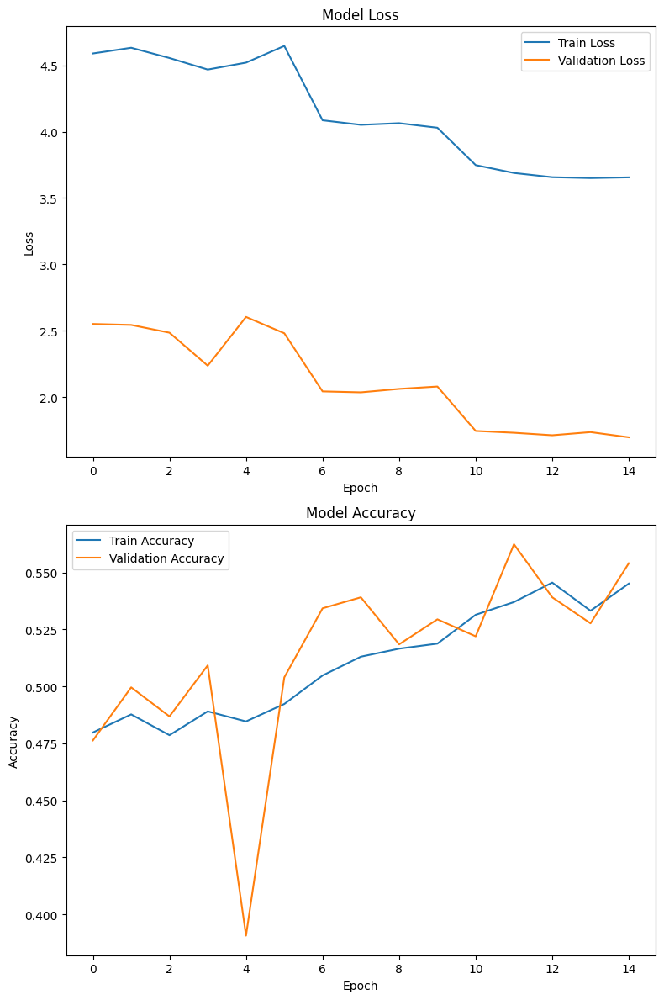

In [54]:
plot_model_history(history)

In [78]:
lenet_model.save("/kaggle/working/lenet_model.h5")

In [30]:
lenet_model.evaluate(validation_dataset)

2278/2278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - accuracy: 0.6859 - loss: 0.8224 - top_k_accuracy: 0.8878


[0.8080156445503235, 0.6887620687484741, 0.8946444392204285]

In [31]:
history_cutmin = lenet_model.fit(
  training_dataset,
  validation_data = validation_dataset,
  epochs = 15,
  verbose = 1,
)

Epoch 1/15
213/213 ━━━━━━━━━━━━━━━━━━━━ 35s 163ms/step - accuracy: 0.8682 - loss: 0.3288 - top_k_accuracy: 0.9713 - val_accuracy: 0.7704 - val_loss: 0.6999 - val_top_k_accuracy: 0.9197
Epoch 2/15
213/213 ━━━━━━━━━━━━━━━━━━━━ 35s 164ms/step - accuracy: 0.8625 - loss: 0.3546 - top_k_accuracy: 0.9713 - val_accuracy: 0.7612 - val_loss: 0.7356 - val_top_k_accuracy: 0.9219
Epoch 3/15
213/213 ━━━━━━━━━━━━━━━━━━━━ 35s 164ms/step - accuracy: 0.8694 - loss: 0.3362 - top_k_accuracy: 0.9755 - val_accuracy: 0.7858 - val_loss: 0.6650 - val_top_k_accuracy: 0.9227
Epoch 4/15
213/213 ━━━━━━━━━━━━━━━━━━━━ 35s 160ms/step - accuracy: 0.8465 - loss: 0.3776 - top_k_accuracy: 0.9693 - val_accuracy: 0.7796 - val_loss: 0.6333 - val_top_k_accuracy: 0.9267
Epoch 5/15
213/213 ━━━━━━━━━━━━━━━━━━━━ 34s 160ms/step - accuracy: 0.8959 - loss: 0.2831 - top_k_accuracy: 0.9794 - val_accuracy: 0.6708 - val_loss: 0.9805 - val_top_k_accuracy: 0.8946
Epoch 6/15
213/213 ━━━━━━━━━━━━━━━━━━━━ 35s 164ms/step - accuracy: 0.8829 -


KeyboardInterrupt



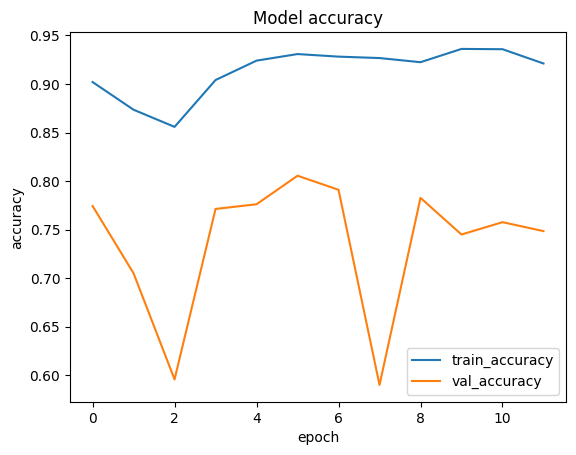

In [77]:
plot_model_history(history_cutmin)

# Testing

In [82]:
test_image = cv2.imread("/kaggle/input/human-emotions-datasethes/Emotions Dataset/Emotions Dataset/test/sad/138882.jpg_brightness_2.jpg")
test_image = cv2.resize(test_image, (CONFIGURATION["IM_SIZE"] ,CONFIGURATION["IM_SIZE"]))
im = tf.constant(test_image, dtype = tf.float32)

im = tf.expand_dims(im, axis = 0)
print(pretrained_model(im))
print(CONFIGURATION['CLASS_NAMES'][tf.argmax(pretrained_model(im), axis = -1).numpy()[0]])

tf.Tensor([[0.62445796 0.05781172 0.31773034]], shape=(1, 3), dtype=float32)
angry


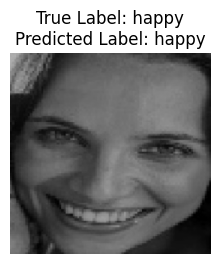

In [92]:
plt.figure(figsize=(12, 12))
for images, labels in validation_dataset:
    batch_size = tf.shape(images)[0]
    num_images_to_plot = min(16, batch_size)
    for i in range(num_images_to_plot):
        ax = plt.subplot(4, 4, i+1)
        plt.imshow(images[i].numpy().astype("uint8"))
        true_label = CONFIGURATION["CLASS_NAMES"][tf.argmax(labels[i], axis=-1).numpy()]
        predicted_label = CONFIGURATION["CLASS_NAMES"][int(tf.argmax(lenet_model(tf.expand_dims(images[i], axis=0)), axis=-1).numpy()[0])]
        plt.title(f"True Label: {true_label}\nPredicted Label: {predicted_label}")
        plt.axis("off")


## Confusion Matrix

In [93]:
predicted = []
labels = []

for im, label in validation_dataset:
  predicted.append(lenet_model(im))
  labels.append(label.numpy())

In [94]:
print(np.concatenate([np.argmax(labels[:-1], axis = -1).flatten(), np.argmax(labels[-1], axis = -1).flatten()]))
print(np.concatenate([np.argmax(predicted[:-1], axis = -1).flatten(), np.argmax(predicted[-1], axis = -1).flatten()]))

[1 2 1 ... 1 0 1]
[1 2 1 ... 1 1 1]


In [95]:
pred = np.concatenate([np.argmax(predicted[:-1], axis = -1).flatten(), np.argmax(predicted[-1], axis = -1).flatten()])
lab = np.concatenate([np.argmax(labels[:-1], axis = -1).flatten(), np.argmax(labels[-1], axis = -1).flatten()])

[[366  97  52]
 [ 53 876  77]
 [110 184 463]]


Text(0.5, 58.7222222222222, 'Predicted')

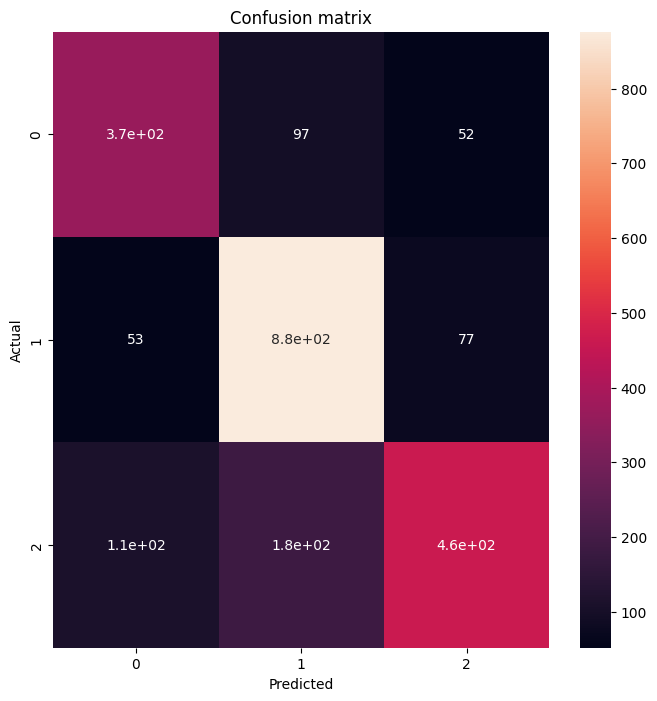

In [96]:
cm = confusion_matrix(lab, pred)
print(cm)
plt.figure(figsize=(8,8))

sns.heatmap(cm, annot=True,)
plt.title('Confusion matrix')
plt.ylabel('Actual')
plt.xlabel('Predicted')

In [102]:
resize_rescale_layers = tf.keras.Sequential([
       Resizing(CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"]),
       Rescaling(1./255),
])

In [103]:
history = lenet_model.fit(
  training_dataset,
  validation_data = validation_dataset,
  epochs = 12,
  verbose = 1
)

Epoch 1/12
213/213 ━━━━━━━━━━━━━━━━━━━━ 64s 295ms/step - accuracy: 0.8168 - loss: 0.7497 - top_k_accuracy: 0.9523 - val_accuracy: 0.6018 - val_loss: 1.0030 - val_top_k_accuracy: 0.8450
Epoch 2/12
213/213 ━━━━━━━━━━━━━━━━━━━━ 63s 289ms/step - accuracy: 0.7884 - loss: 0.6608 - top_k_accuracy: 0.9429 - val_accuracy: 0.7726 - val_loss: 0.5775 - val_top_k_accuracy: 0.9232
Epoch 3/12
213/213 ━━━━━━━━━━━━━━━━━━━━ 63s 292ms/step - accuracy: 0.8305 - loss: 0.6078 - top_k_accuracy: 0.9636 - val_accuracy: 0.7941 - val_loss: 0.5356 - val_top_k_accuracy: 0.9271
Epoch 4/12
213/213 ━━━━━━━━━━━━━━━━━━━━ 63s 291ms/step - accuracy: 0.8391 - loss: 0.5967 - top_k_accuracy: 0.9585 - val_accuracy: 0.7954 - val_loss: 0.5377 - val_top_k_accuracy: 0.9302
Epoch 5/12
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 287ms/step - accuracy: 0.8529 - loss: 0.5825 - top_k_accuracy: 0.9623 - val_accuracy: 0.7730 - val_loss: 0.6138 - val_top_k_accuracy: 0.9227
Epoch 6/12
213/213 ━━━━━━━━━━━━━━━━━━━━ 64s 295ms/step - accuracy: 0.8578 -

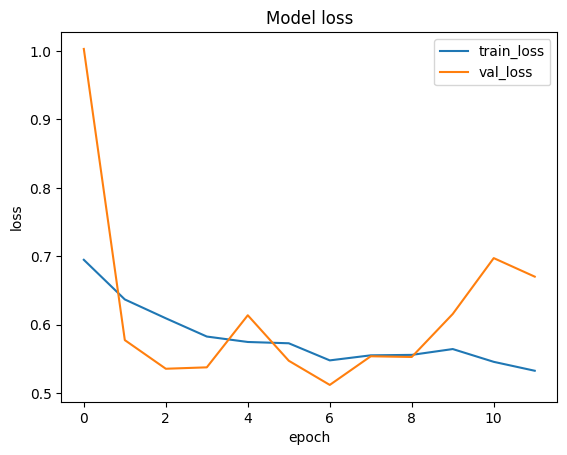

In [107]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train_loss', 'val_loss'])
plt.show()

# TF Records implementation


In [118]:
training_dataset = (
    training_dataset
    .unbatch()
)

In [119]:
validation_dataset = (
    validation_dataset
    .unbatch()
)

In [120]:
def create_example(image, label):

  bytes_feature = Feature(
      bytes_list=BytesList(value=[image]))

  int_feature = Feature(
      int64_list=Int64List(value=[label]))

  example = Example(
      features=Features(feature={
          'images': bytes_feature,
          'labels': int_feature,
      }))

  return example.SerializeToString()

In [121]:
!mkdir tfrecords

mkdir: cannot create directory 'tfrecords': File exists


In [122]:
NUM_SHARDS = 10
PATH = 'tfrecords/shard_{:02d}.tfrecord'

In [123]:
def encode_image(image, label):
  image = tf.image.convert_image_dtype(image, dtype=tf.uint8)
  image = tf.io.encode_jpeg(image)
  return image,tf.argmax(label)

In [124]:
encoded_dataset = (
  training_dataset
  .map(encode_image)
)

In [125]:
for shard_number in range(NUM_SHARDS):

  sharded_dataset = (
      encoded_dataset
      .shard(NUM_SHARDS, shard_number)
      .as_numpy_iterator()
  )

  with tf.io.TFRecordWriter(PATH.format(shard_number)) as file_writer:
    for encoded_image, encoded_label in sharded_dataset:

      example = create_example(encoded_image, encoded_label)
      file_writer.write(example)

In [126]:
recons_dataset = tf.data.TFRecordDataset(
    filenames =[PATH.format(p) for p in range(NUM_SHARDS-2)] )
# val_recons_dataset = tf.data.TFRecordDataset(
#     filenames =[PATH.format(p) for p in range(NUM_SHARDS-2,NUM_SHARDS)] )


In [127]:
def parse_tfrecords(example):

    feature_description = {
          "images": tf.io.FixedLenFeature([], tf.string),
          "labels": tf.io.FixedLenFeature([], tf.int64),
      }

    example = tf.io.parse_single_example(example, feature_description)
    example["images"] = tf.image.convert_image_dtype(
        tf.io.decode_jpeg(
        example["images"], channels = 3), dtype = tf.float32)

    return example["images"], example["labels"]


In [128]:
parsed_dataset = (
    recons_dataset
    .map(parse_tfrecords)
    .batch(CONFIGURATION["BATCH_SIZE"])
    .prefetch(tf.data.AUTOTUNE)
)


In [131]:
parsed_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, None, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [132]:
for i in parsed_dataset.take(1):
  print(i)

(<tf.Tensor: shape=(32, 256, 256, 3), dtype=float32, numpy=
array([[[[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]],

        [[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]],

        [[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]],

        ...,

        [[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]],

        [[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]],

        [[1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.],
         ...,
         [1., 1., 1.],
         [1., 1., 1.],
         [1., 1., 1.]]],




## Custom_Conv_2d layer

In [55]:
class CustomConv2D(Layer):
    def __init__(self, n_filters, kernel_size, n_strides, padding='valid'):
        super(CustomConv2D, self).__init__(name='custom_conv2d')

        self.conv = Conv2D(
            filters=n_filters,
            kernel_size=kernel_size,
            activation='relu',
            strides=n_strides,
            padding=padding
        )

        self.batch_norm = BatchNormalization()

    def call(self, x, training=True):
        x = self.conv(x)
        x = self.batch_norm(x, training=training)  # Explicitly pass `training` as a keyword argument
        return x


## Residual block

In [56]:
class ResidualBlock(Layer):
  def __init__(self, n_channels, n_strides = 1):
    super(ResidualBlock, self).__init__(name = 'res_block')

    self.dotted = (n_strides != 1)

    self.custom_conv_1 = CustomConv2D(n_channels, 3, n_strides, padding = "same")
    self.custom_conv_2 = CustomConv2D(n_channels, 3, 1, padding = "same")

    self.activation = Activation('relu')

    if self.dotted:
      self.custom_conv_3 = CustomConv2D(n_channels, 1, n_strides)

  def call(self, input, training):

    x = self.custom_conv_1(input, training=training)
    x = self.custom_conv_2(x, training=training)

    if self.dotted:
      x_add = self.custom_conv_3(input, training=training)
      x_add = Add()([x, x_add])
    else:
      x_add = Add()([x, input])

    return self.activation(x_add)


### Complete Network

In [57]:
class ResNet34(Model):
  def __init__(self,):
    super(ResNet34, self).__init__(name = 'resnet_34')

    self.conv_1 = CustomConv2D(64, 7, 2, padding = 'same')
    self.max_pool = MaxPooling2D(3,2)

    self.conv_2_1 = ResidualBlock(64)
    self.conv_2_2 = ResidualBlock(64)
    self.conv_2_3 = ResidualBlock(64)

    self.conv_3_1 = ResidualBlock(128, 2)
    self.conv_3_2 = ResidualBlock(128)
    self.conv_3_3 = ResidualBlock(128)
    self.conv_3_4 = ResidualBlock(128)

    self.conv_4_1 = ResidualBlock(256, 2)
    self.conv_4_2 = ResidualBlock(256)
    self.conv_4_3 = ResidualBlock(256)
    self.conv_4_4 = ResidualBlock(256)
    self.conv_4_5 = ResidualBlock(256)
    self.conv_4_6 = ResidualBlock(256)

    self.conv_5_1 = ResidualBlock(512, 2)
    self.conv_5_2 = ResidualBlock(512)
    self.conv_5_3 = ResidualBlock(512)

    self.global_pool = GlobalAveragePooling2D()

    self.fc_3 = Dense(CONFIGURATION["NUM_CLASSES"], activation = 'softmax')

  def call(self, x, training=True):
    x = self.conv_1(x)
    x = self.max_pool(x)

    x = self.conv_2_1(x, training=training)
    x = self.conv_2_2(x, training=training)
    x = self.conv_2_3(x, training=training)

    x = self.conv_3_1(x, training=training)
    x = self.conv_3_2(x, training=training)
    x = self.conv_3_3(x, training=training)
    x = self.conv_3_4(x, training=training)

    x = self.conv_4_1(x, training=training)
    x = self.conv_4_2(x, training=training)
    x = self.conv_4_3(x, training=training)
    x = self.conv_4_4(x, training=training)
    x = self.conv_4_5(x, training=training)
    x = self.conv_4_6(x, training=training)

    x = self.conv_5_1(x, training=training)
    x = self.conv_5_2(x, training=training)
    x = self.conv_5_3(x, training=training)

    x = self.global_pool(x)

    return self.fc_3(x)


In [58]:
resnet_34 = ResNet34()
resnet_34(tf.zeros([1, 256, 256, 3]))
resnet_34.summary()


Model: "resnet_34"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ custom_conv2d (CustomConv2D)    │ ?                      │         9,728 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ ?                      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │        74,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │        74,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │        74,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │       231,296 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │       296,192 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │       296,192 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │       296,192 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │       921,344 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │     1,182,208 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │     1,182,208 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │     1,182,208 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │     1,182,208 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │     1,182,208 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │     3,677,696 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │     4,723,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ res_block (ResidualBlock)       │ ?                      │     4,723,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ ?                      │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ ?                      │         1,539 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 21,311,747 (81.30 MB)

 Trainable params: 21,294,723 (81.23 MB)

 Non-trainable params: 17,024 (66.50 KB)

In [59]:
loss_function = CategoricalCrossentropy()

In [60]:

metrics = [CategoricalAccuracy(name = "accuracy")]

In [61]:
resnet_34.compile(
  optimizer = Adam(learning_rate = CONFIGURATION["LEARNING_RATE"]),
  loss = loss_function,
  metrics = metrics,
)

In [62]:
history = resnet_34.fit(
  training_dataset,
  validation_data = validation_dataset,
  epochs = 20,
  verbose = 1,
  class_weight = class_weights,
  callbacks = [lr_scheduler,early_stopping]
)

Epoch 1/20
  1/213 ━━━━━━━━━━━━━━━━━━━━ 1:50:17 31s/step - accuracy: 0.4062 - loss: 5.7257

I0000 00:00:1734282463.404814     107 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_19', 4 bytes spill stores, 12 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_42', 4 bytes spill stores, 12 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_7', 4 bytes spill stores, 12 bytes spill loads



213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - accuracy: 0.4002 - loss: 5.7510

I0000 00:00:1734282502.340746     105 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_19', 4 bytes spill stores, 12 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_44', 4 bytes spill stores, 12 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_7', 4 bytes spill stores, 12 bytes spill loads



213/213 ━━━━━━━━━━━━━━━━━━━━ 88s 266ms/step - accuracy: 0.4003 - loss: 5.7427 - val_accuracy: 0.3982 - val_loss: 1.8829 - learning_rate: 0.0010
Epoch 2/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 45s 211ms/step - accuracy: 0.4373 - loss: 3.3416 - val_accuracy: 0.3209 - val_loss: 2.2764 - learning_rate: 0.0010
Epoch 3/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 46s 214ms/step - accuracy: 0.5289 - loss: 3.0040 - val_accuracy: 0.4934 - val_loss: 1.1373 - learning_rate: 0.0010
Epoch 4/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 45s 208ms/step - accuracy: 0.5744 - loss: 2.7508 - val_accuracy: 0.4596 - val_loss: 2.2409 - learning_rate: 0.0010
Epoch 5/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 46s 212ms/step - accuracy: 0.6157 - loss: 2.6176 - val_accuracy: 0.4952 - val_loss: 1.1688 - learning_rate: 0.0010
Epoch 6/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 46s 212ms/step - accuracy: 0.6789 - loss: 2.2688 - val_accuracy: 0.5896 - val_loss: 0.9760 - learning_rate: 5.0000e-04
Epoch 7/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 45s 209ms/step - accuracy: 0.7052 - l

## Previous

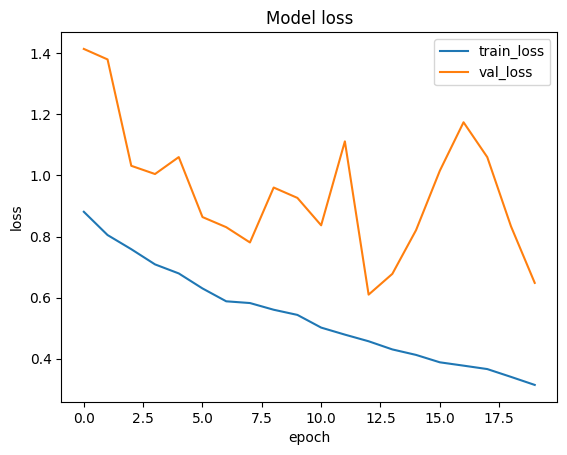

In [64]:
# plt.plot(history.history['loss'])
# plt.plot(history.history['val_loss'])
# plt.title('Model loss')
# plt.ylabel('loss')
# plt.xlabel('epoch')
# plt.legend(['train_loss', 'val_loss'])
# plt.show()

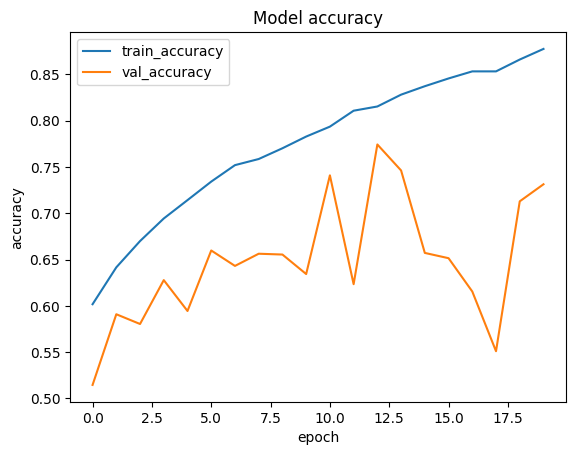

In [65]:
# plt.plot(history.history['accuracy'])
# plt.plot(history.history['val_accuracy'])
# plt.title('Model accuracy')
# plt.ylabel('accuracy')
# plt.xlabel('epoch')
# plt.legend(['train_accuracy', 'val_accuracy'])
# plt.show()

In [168]:
resnet_34.evaluate(validation_dataset)

2278/2278 ━━━━━━━━━━━━━━━━━━━━ 19s 8ms/step - accuracy: 0.6123 - loss: 0.9001


[0.9010651707649231, 0.6053555607795715]

## Pretranined Model

In [72]:
backbone = tf.keras.applications.efficientnet.EfficientNetB4(
    include_top = False,
    weights='imagenet',
    input_shape=(CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"], 3),
    )

In [73]:
backbone.trainable = False

In [74]:
pretrained_model = tf.keras.Sequential([
    Input(shape = (CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"],3)),
    backbone,
    GlobalAveragePooling2D(),
    Dense( CONFIGURATION["N_DENSE_1"], activation = "relu"),
    BatchNormalization(),
    Dense( CONFIGURATION["N_DENSE_2"], activation = "relu"),
    Dense( CONFIGURATION["NUM_CLASSES"], activation = "softmax"),

    ])
pretrained_model.summary()

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ efficientnetb4 (Functional)     │ (None, 8, 8, 1792)     │    17,673,823 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_3      │ (None, 1792)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 1024)           │     1,836,032 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_46          │ (None, 1024)           │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 3)              │         1,539 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 20,040,290 (76.45 MB)

 Trainable params: 2,364,419 (9.02 MB)

 Non-trainable params: 17,675,871 (67.43 MB)

In [75]:
loss_function = CategoricalCrossentropy()

In [76]:

metrics = [CategoricalAccuracy(name = "accuracy")]

In [77]:
backbone.trainable=False

In [78]:
pretrained_model.compile(
  optimizer = Adam(learning_rate = CONFIGURATION["LEARNING_RATE"]),
  loss = loss_function,
  metrics = metrics,
)

In [79]:
history = pretrained_model.fit(
  training_dataset,
  validation_data = validation_dataset,
  epochs = 20,
  verbose = 1,
  class_weight = class_weights,
  callbacks = [lr_scheduler,early_stopping]
)

Epoch 1/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 182s 538ms/step - accuracy: 0.6043 - loss: 3.4022 - val_accuracy: 0.7116 - val_loss: 0.7216 - learning_rate: 0.0010
Epoch 2/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 58s 270ms/step - accuracy: 0.7244 - loss: 2.0183 - val_accuracy: 0.7450 - val_loss: 0.5873 - learning_rate: 0.0010
Epoch 3/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 57s 267ms/step - accuracy: 0.7694 - loss: 1.7030 - val_accuracy: 0.7713 - val_loss: 0.5457 - learning_rate: 0.0010
Epoch 4/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 57s 267ms/step - accuracy: 0.7966 - loss: 1.4898 - val_accuracy: 0.7700 - val_loss: 0.5571 - learning_rate: 0.0010
Epoch 5/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 55s 255ms/step - accuracy: 0.8090 - loss: 1.4092 - val_accuracy: 0.7932 - val_loss: 0.5007 - learning_rate: 0.0010
Epoch 6/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 54s 254ms/step - accuracy: 0.8149 - loss: 1.3639 - val_accuracy: 0.7638 - val_loss: 0.5836 - learning_rate: 0.0010
Epoch 7/20
213/213 ━━━━━━━━━━━━━━━━━━━━ 54s 252ms/step - accuracy: 0.

In [70]:
backbone.trainable = True

In [71]:
input = Input(shape = (CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"],3))

x = backbone(input, training = False)
x = GlobalAveragePooling2D()(x)
x = Dense( CONFIGURATION["N_DENSE_1"], activation = "relu")(x)
x = BatchNormalization()(x)
x = Dense( CONFIGURATION["N_DENSE_2"], activation = "relu")(x)
output = Dense( CONFIGURATION["NUM_CLASSES"], activation = "softmax")(x)

finetuned_model = Model(input, output)

In [209]:
finetuned_model.summary()

Model: "functional_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_10 (InputLayer)     │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetb4 (Functional)     │ (None, 8, 8, 1792)     │    17,673,823 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_15     │ (None, 1792)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 1024)           │     1,836,032 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_435         │ (None, 1024)           │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 3)              │         1,539 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 20,040,290 (76.45 MB)

 Trainable params: 19,913,035 (75.96 MB)

 Non-trainable params: 127,255 (497.09 KB)

In [210]:
loss_function = CategoricalCrossentropy()

In [211]:

metrics = [CategoricalAccuracy(name = "accuracy")]

In [212]:
finetuned_model.compile(
  optimizer = Adam(learning_rate = CONFIGURATION["LEARNING_RATE"] / 100),
  loss = loss_function,
  metrics = metrics,
)

In [213]:
history = finetuned_model.fit(
  training_dataset,
  validation_data = validation_dataset,
  epochs = 5,
  verbose = 1
)

Epoch 1/5


I0000 00:00:1734186812.554335     123 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion_12', 4 bytes spill stores, 4 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion_51__8', 8 bytes spill stores, 8 bytes spill loads



212/213 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step - accuracy: 0.3639 - loss: 1.3312

I0000 00:00:1734187004.737985     122 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion_11', 4 bytes spill stores, 4 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion_696__8', 8 bytes spill stores, 8 bytes spill loads



213/213 ━━━━━━━━━━━━━━━━━━━━ 456s 1s/step - accuracy: 0.3645 - loss: 1.3300 - val_accuracy: 0.4987 - val_loss: 1.0185
Epoch 2/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 73s 338ms/step - accuracy: 0.6031 - loss: 0.8770 - val_accuracy: 0.5694 - val_loss: 0.9268
Epoch 3/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 73s 338ms/step - accuracy: 0.6840 - loss: 0.7205 - val_accuracy: 0.6449 - val_loss: 0.8194
Epoch 4/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 72s 334ms/step - accuracy: 0.7288 - loss: 0.6423 - val_accuracy: 0.7090 - val_loss: 0.6750
Epoch 5/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 71s 332ms/step - accuracy: 0.7543 - loss: 0.5738 - val_accuracy: 0.7366 - val_loss: 0.6135


In [ ]:
history = resnet_34.fit(
  training_dataset,
  validation_data = validation_dataset,
  epochs = 20,
  verbose = 1,
  class_weight = class_weights,
  callbacks = [lr_scheduler,early_stopping]
)

In [215]:
test_image = cv2.imread("/kaggle/input/human-emotions-datasethes/Emotions Dataset/Emotions Dataset/test/angry/101810.jpg_brightness_1.jpg")
test_image = cv2.resize(test_image, (CONFIGURATION["IM_SIZE"] ,CONFIGURATION["IM_SIZE"]))
im = tf.constant(test_image, dtype = tf.float32)

im = tf.expand_dims(im, axis = 0)
print(pretrained_model(im))
print(CONFIGURATION['CLASS_NAMES'][tf.argmax(pretrained_model(im), axis = -1).numpy()[0]])

tf.Tensor([[0.00e+00 6.25e-05 1.00e+00]], shape=(1, 3), dtype=float16)
sad


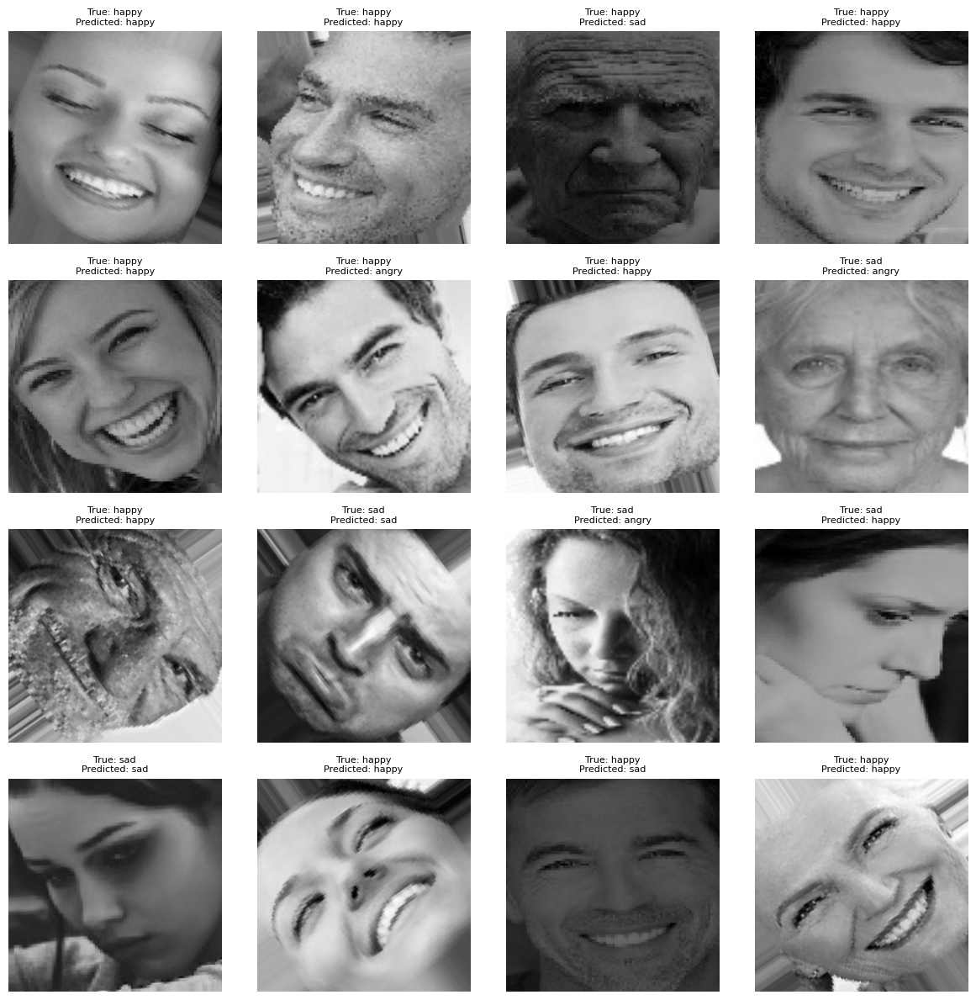

In [222]:
import matplotlib.pyplot as plt
import tensorflow as tf

# Initialize the plot
plt.figure(figsize=(12, 12))
max_images = 16  # Total images to display
count = 0  # Counter for plotted images

# Iterate through the validation dataset
for images, labels in validation_dataset:
    for i in range(images.shape[0]):
        if count >= max_images:
            break  # Stop if we've reached the desired number of images

        ax = plt.subplot(4, 4, count + 1)  # Create subplot
        plt.imshow(images[i].numpy() / 255.0)  # Display image

        # Extract the true label index from one-hot encoded labels
        true_label_index = int(tf.argmax(labels[i], axis=-1).numpy())
        true_label = CONFIGURATION["CLASS_NAMES"][true_label_index]

        # Predict the label using the pretrained model
        predictions = pretrained_model(tf.expand_dims(images[i], axis=0))
        predicted_class_index = int(tf.argmax(predictions, axis=-1).numpy()[0])
        predicted_label = CONFIGURATION["CLASS_NAMES"][predicted_class_index]

        # Set the title with true and predicted labels
        plt.title(f"True: {true_label}\nPredicted: {predicted_label}", fontsize=8)
        plt.axis("off")  # Hide axes for clarity

        count += 1  # Increment the counter

    if count >= max_images:
        break  # Exit the outer loop as well

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


# VGG Model 

In [18]:
vgg_backbone = tf.keras.applications.vgg16.VGG16(
    include_top=False,
    weights= None,
    input_shape=(CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"], 3),

)

In [19]:
vgg_backbone.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 256, 256, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 256, 256, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 128, 128, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 128, 128, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 64, 64, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 32, 32, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 16, 16, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 8, 8, 512)      │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

In [20]:
def is_conv(layer_name):
  if 'conv' in layer_name:
    return True
  else:
    return False

In [21]:
feature_maps = [layer.output for layer in vgg_backbone.layers[1:] if is_conv(layer.name)]
feature_map_model = Model(
    inputs = vgg_backbone.input,
    outputs = feature_maps
)

feature_map_model.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 256, 256, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 256, 256, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 128, 128, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 128, 128, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 64, 64, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 32, 32, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 16, 16, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

In [22]:
test_image = cv2.imread("/kaggle/input/human-emotions-datasethes/Emotions Dataset/Emotions Dataset/test/angry/101810.jpg_brightness_1.jpg")
test_image = cv2.resize(test_image, (CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"]))

im = tf.constant(test_image, dtype = tf.float32)
im = tf.expand_dims(im, axis = 0)

f_maps = feature_map_model.predict(im)

I0000 00:00:1734188951.564328     224 service.cc:145] XLA service 0x7c693c004680 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1734188951.564379     224 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


I0000 00:00:1734188953.255631     224 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


In [23]:
for i in range(len(f_maps)):
  print(f_maps[i].shape)

(1, 256, 256, 64)
(1, 256, 256, 64)
(1, 128, 128, 128)
(1, 128, 128, 128)
(1, 64, 64, 256)
(1, 64, 64, 256)
(1, 64, 64, 256)
(1, 32, 32, 512)
(1, 32, 32, 512)
(1, 32, 32, 512)
(1, 16, 16, 512)
(1, 16, 16, 512)
(1, 16, 16, 512)


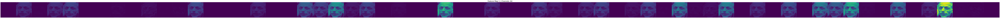

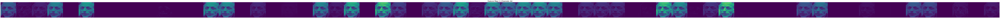

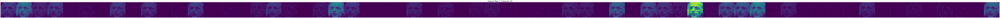

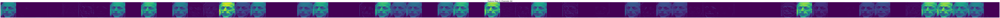

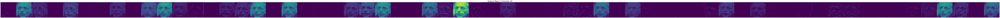

...

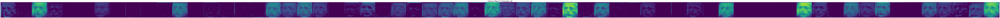

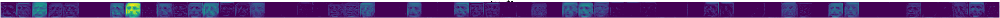

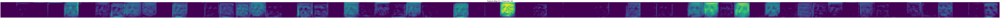

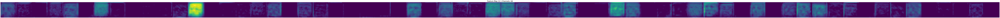

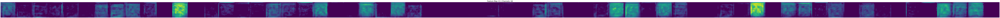

In [33]:
import matplotlib.pyplot as plt
import numpy as np

# Adjust the max number of channels to display
max_channels = 64  # Display only a subset if channels are too many

# Increase figure size for better visibility
fig_width = 36  # Larger width
fig_height = 36  # Larger height

for i in range(len(f_maps)):
    f_size = f_maps[i].shape[1]
    n_channels = min(f_maps[i].shape[3], max_channels)  # Limit channels

    # Initialize a blank map for visualization
    joint_maps = np.ones((f_size, f_size * n_channels))

    # Combine feature maps into a single image
    for j in range(n_channels):
        joint_maps[:, f_size * j:f_size * (j + 1)] = f_maps[i][..., j]

    # Plot and show
    plt.figure(figsize = (256,256))
    plt.imshow(joint_maps[:, :f_size * n_channels], cmap='viridis')
    plt.axis("off")
    plt.title(f"Feature Map {i + 1} | Channels: {n_channels}", fontsize=24)  # Increase font size
    plt.show()
    plt.close()  # Free memory after each plot


## Transfer Learning with MobileNetV2

In [49]:
backbone = tf.keras.applications.mobilenet_v2.MobileNetV2(
    include_top = False,
    weights='imagenet',
    input_shape=(CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"], 3),
    )

/tmp/ipykernel_23/3786300760.py:1: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  backbone = tf.keras.applications.mobilenet_v2.MobileNetV2(


In [50]:
backbone.trainable = False

In [51]:
pretrained_model = tf.keras.Sequential([
    Input(shape = (CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"],3)),
    backbone,
    GlobalAveragePooling2D(),
    Dense( CONFIGURATION["N_DENSE_1"], activation = "relu"),
    BatchNormalization(),
    Dense( CONFIGURATION["N_DENSE_2"], activation = "relu"),
    Dense( CONFIGURATION["NUM_CLASSES"], activation = "softmax"),

    ])
pretrained_model.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 8, 8, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_4      │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 1024)           │     1,311,744 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 1024)           │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 3)              │         1,539 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,100,163 (15.64 MB)

 Trainable params: 1,840,131 (7.02 MB)

 Non-trainable params: 2,260,032 (8.62 MB)

# Grad Cam

In [52]:
backbone = tf.keras.applications.efficientnet.EfficientNetB5(
    include_top = False,
    weights='imagenet',
    input_shape=(CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"], 3),
    )
backbone.trainable=False

In [53]:
x = backbone.output

x = GlobalAveragePooling2D()(x)
x = Dense( CONFIGURATION["N_DENSE_1"], activation = "relu")(x)
x = Dense( CONFIGURATION["N_DENSE_2"], activation = "relu")(x)
output = Dense( CONFIGURATION["NUM_CLASSES"], activation = "softmax")(x)

pretrained_model = Model(backbone.inputs, output)
pretrained_model.summary()

Model: "functional_8"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_15      │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_3         │ (None, 256, 256,  │          0 │ input_layer_15[0… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ normalization_1     │ (None, 256, 256,  │          7 │ rescaling_3[0][0] │
│ (Normalization)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_4         │ (None, 256, 256,  │          0 │ normalization_1[… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv_pad       │ (None, 257, 257,  │          0 │ rescaling_4[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv (Conv2D)  │ (None, 128, 128,  │      1,296 │ stem_conv_pad[0]… │
│                     │ 48)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_bn             │ (None, 128, 128,  │        192 │ stem_conv[0][0]   │
│ (BatchNormalizatio… │ 48)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_activation     │ (None, 128, 128,  │          0 │ stem_bn[0][0]     │
│ (Activation)        │ 48)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_dwconv      │ (None, 128, 128,  │        432 │ stem_activation[… │
│ (DepthwiseConv2D)   │ 48)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_bn          │ (None, 128, 128,  │        192 │ block1a_dwconv[0… │
│ (BatchNormalizatio… │ 48)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_activation  │ (None, 128, 128,  │          0 │ block1a_bn[0][0]  │
│ (Activation)        │ 48)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_squeeze  │ (None, 48)        │          0 │ block1a_activati… │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reshape  │ (None, 1, 1, 48)  │          0 │ block1a_se_squee… │
│ (Reshape)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reduce   │ (None, 1, 1, 12)  │        588 │ block1a_se_resha… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_expand   │ (None, 1, 1, 48)  │        624 │ block1a_se_reduc… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_excite   │ (None, 128, 128,  │          0 │ block1a_activati… │
│ (Multiply)          │ 48)               │            │ block1a_se_expan… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_co… │ (None, 128, 128,  │      1,152 │ block1a_se_excit

 Total params: 31,138,042 (118.78 MB)

 Trainable params: 2,624,515 (10.01 MB)

 Non-trainable params: 28,513,527 (108.77 MB)

In [54]:
img_path = "/kaggle/input/human-emotions-datasethes/Emotions Dataset/Emotions Dataset/test/angry/101810.jpg_brightness_1.jpg"

In [55]:
test_image = cv2.imread(img_path)
test_image = cv2.resize(test_image, (CONFIGURATION["IM_SIZE"] ,CONFIGURATION["IM_SIZE"]))
im = tf.constant(test_image, dtype = tf.float32)
img_array = tf.expand_dims(im, axis = 0)
print(img_array.shape)

(1, 256, 256, 3)


In [56]:
preds = pretrained_model.predict(img_array)

1/1 ━━━━━━━━━━━━━━━━━━━━ 11s 11s/step


In [57]:
print(preds)

[[0.33566707 0.21813594 0.446197  ]]


In [58]:
np.argmax(preds[0])

2

In [60]:
last_conv_layer_name = "top_activation"  # Replace with the correct layer name
last_conv_layer = pretrained_model.get_layer(last_conv_layer_name)
last_conv_layer_model = Model(pretrained_model.inputs, last_conv_layer.output)

In [68]:
classifier_layer_names = [
 "global_average_pooling2d_5",
 "dense_11",
 "dense_12",
 "dense_13"
]

In [69]:
classifier_input = Input(shape=(8,8,2048))
x = classifier_input
for layer_name in classifier_layer_names:
 x = pretrained_model.get_layer(layer_name)(x)
classifier_model = Model(classifier_input, x)

In [70]:
with tf.GradientTape() as tape:
  last_conv_layer_output = last_conv_layer_model(img_array)
  preds = classifier_model(last_conv_layer_output)
  top_pred_index = tf.argmax(preds[0])
  print(top_pred_index)
  top_class_channel = preds[:, top_pred_index]

grads = tape.gradient(top_class_channel, last_conv_layer_output)

tf.Tensor(2, shape=(), dtype=int64)


In [71]:
grads.shape

TensorShape([1, 8, 8, 2048])

In [72]:
pooled_grads = tf.reduce_mean(grads, axis=(0,1,2)).numpy()

In [73]:
print(pooled_grads.shape)

(2048,)


In [74]:
last_conv_layer_output = last_conv_layer_output.numpy()[0]
for i in range(2048):
  last_conv_layer_output[:, :, i] *= pooled_grads[i]

In [75]:
print(last_conv_layer_output.shape)

(8, 8, 2048)


In [76]:
heatmap = np.sum(last_conv_layer_output, axis=-1)

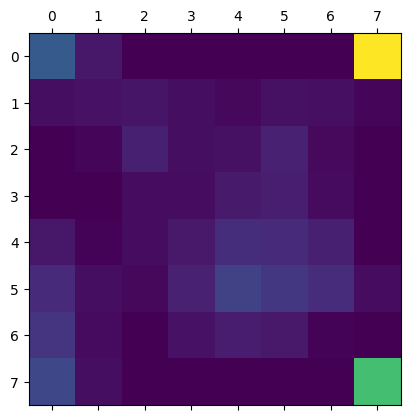

In [77]:
heatmap=tf.nn.relu(heatmap)
plt.matshow(heatmap)

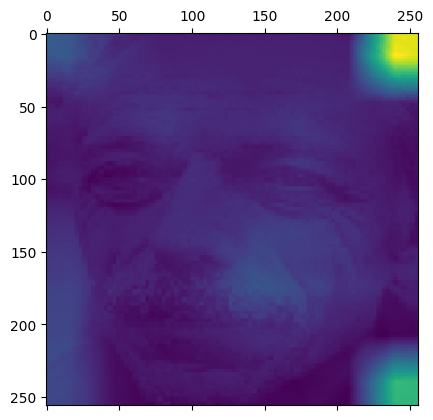

In [78]:
resized_heatmap=cv2.resize(np.array(heatmap),(256,256))
plt.matshow(resized_heatmap*255+img_array[0,:,:,0]/255)

In [87]:
inputs = Input(shape = (CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"], 3))

y_1 = resnet_34(inputs)
y_2 = pretrained_model(inputs)

output = 0.5*y_1 + 0.5*y_1

ensemble_model = Model(inputs = inputs, outputs = output)

In [89]:
ensemble_model.compile(
  optimizer = Adam(learning_rate = CONFIGURATION["LEARNING_RATE"]),
  loss = loss_function,
  metrics = metrics,
)

In [90]:
ensemble_model.evaluate(validation_dataset)

2278/2278 ━━━━━━━━━━━━━━━━━━━━ 17s 7ms/step - accuracy: 0.6017 - loss: 0.0000e+00


[0.0, 0.0, 0.5948200225830078, 0.5948200225830078]

## Vision Transformers

In [25]:
test_image = cv2.imread("/kaggle/input/human-emotions-datasethes/Emotions Dataset/Emotions Dataset/train/sad/10416.jpg_brightness_2.jpg")
test_image = cv2.resize(test_image, (CONFIGURATION["IM_SIZE"] ,CONFIGURATION["IM_SIZE"]))

In [26]:
patches = tf.image.extract_patches(images=tf.expand_dims(test_image, axis = 0),
                           sizes=[1, CONFIGURATION["PATCH_SIZE"], CONFIGURATION["PATCH_SIZE"], 1],
                           strides=[1, CONFIGURATION["PATCH_SIZE"], CONFIGURATION["PATCH_SIZE"], 1],
                           rates=[1, 1, 1, 1],
                           padding='VALID')

In [27]:
print(patches.shape)
patches = tf.reshape(patches, (patches.shape[0], -1, 768))
print(patches.shape)

(1, 16, 16, 768)
(1, 256, 768)


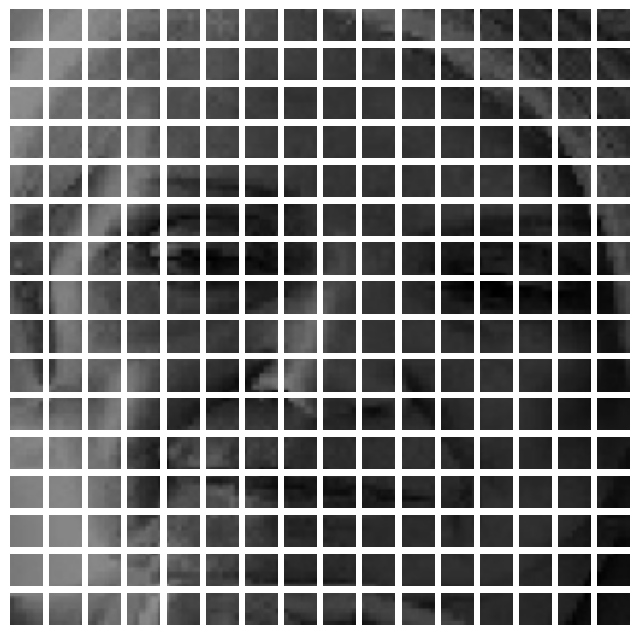

In [28]:
plt.figure(figsize = (8,8))

for i in range(patches.shape[1]):

    ax = plt.subplot(16,16, i+1)
    plt.imshow(tf.reshape(patches[0,i,:], (16,16,3)))
    plt.axis("off")

## Patch Encoder

In [29]:
class PatchEncoder(Layer):
  def __init__(self, N_PATCHES, HIDDEN_SIZE):
    super(PatchEncoder, self).__init__(name = 'patch_encoder')

    self.linear_projection = Dense(HIDDEN_SIZE)
    self.positional_embedding = Embedding(N_PATCHES, HIDDEN_SIZE )
    self.N_PATCHES = N_PATCHES

  def call(self, x):
    patches = tf.image.extract_patches(
        images=x,
        sizes=[1, CONFIGURATION["PATCH_SIZE"], CONFIGURATION["PATCH_SIZE"], 1],
        strides=[1, CONFIGURATION["PATCH_SIZE"], CONFIGURATION["PATCH_SIZE"], 1],
        rates=[1, 1, 1, 1],
        padding='VALID')

    patches = tf.reshape(patches, (tf.shape(patches)[0], 256, patches.shape[-1]))

    embedding_input = tf.range(start = 0, limit = self.N_PATCHES, delta = 1 )
    output = self.linear_projection(patches) + self.positional_embedding(embedding_input)

    return output

### TransformerEncoder

In [30]:
class TransformerEncoder(Layer):
  def __init__(self, N_HEADS, HIDDEN_SIZE):
    super(TransformerEncoder, self).__init__(name = 'transformer_encoder')

    self.layer_norm_1 = LayerNormalization()
    self.layer_norm_2 = LayerNormalization()

    self.multi_head_att = MultiHeadAttention(N_HEADS, HIDDEN_SIZE )

    self.dense_1 = Dense(HIDDEN_SIZE, activation = tf.nn.gelu)
    self.dense_2 = Dense(HIDDEN_SIZE, activation = tf.nn.gelu)

  def call(self, input):
    x_1 = self.layer_norm_1(input)
    x_1 = self.multi_head_att(x_1, x_1)

    x_1 = Add()([x_1, input])

    x_2 = self.layer_norm_2(x_1)
    x_2 = self.dense_1(x_2)
    output = self.dense_2(x_2)
    output = Add()([output, x_1])

    return output

### ViT Model

In [31]:
class ViT(Model):
  def __init__(self, N_HEADS, HIDDEN_SIZE, N_PATCHES, N_LAYERS, N_DENSE_UNITS):
    super(ViT, self).__init__(name = 'vision_transformer')
    self.N_LAYERS = N_LAYERS
    self.patch_encoder = PatchEncoder(N_PATCHES, HIDDEN_SIZE)
    self.trans_encoders = [TransformerEncoder(N_HEADS, HIDDEN_SIZE) for _ in range(N_LAYERS)]
    self.dense_1 = Dense(N_DENSE_UNITS, tf.nn.gelu)
    self.dense_2 = Dense(N_DENSE_UNITS, tf.nn.gelu)
    self.dense_3 = Dense(CONFIGURATION["NUM_CLASSES"], activation = 'softmax')
  def call(self, input, training = True):

    x = self.patch_encoder(input)

    for i in range(self.N_LAYERS):
      x = self.trans_encoders[i](x)
    x = Flatten()(x)
    x = self.dense_1(x)
    x = self.dense_2(x)

    return self.dense_3(x)

In [32]:
vit = ViT(
    N_HEADS = 4, HIDDEN_SIZE = 768, N_PATCHES = 256,
    N_LAYERS = 2, N_DENSE_UNITS = 128)
vit(tf.zeros([2,256,256,3]))

<tf.Tensor: shape=(2, 3), dtype=float32, numpy=
array([[0.41446728, 0.4145583 , 0.17097445],
       [0.41446728, 0.4145583 , 0.17097445]], dtype=float32)>

In [33]:
vit.summary()

Model: "vision_transformer"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ patch_encoder (PatchEncoder)    │ ?                      │       787,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ transformer_encoder             │ ?                      │    10,631,424 │
│ (TransformerEncoder)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ transformer_encoder             │ ?                      │    10,631,424 │
│ (TransformerEncoder)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ ?                      │    25,165,952 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ ?                      │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ ?                      │           387 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 47,232,899 (180.18 MB)

 Trainable params: 47,232,899 (180.18 MB)

 Non-trainable params: 0 (0.00 B)

In [34]:
vit.compile(
  optimizer = Adam(learning_rate = CONFIGURATION["LEARNING_RATE"]),
  loss = loss_function,
  metrics = metrics,
)

In [30]:
history = vit.fit(
  training_dataset,
  validation_data = validation_dataset,
  epochs = 5,
  verbose = 1,
  callb
)

Epoch 1/5


I0000 00:00:1734245163.708956      97 service.cc:145] XLA service 0x7fe1cc004390 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1734245163.709036      97 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0


  1/213 ━━━━━━━━━━━━━━━━━━━━ 41:40 12s/step - accuracy: 0.1875 - loss: 75.1515

I0000 00:00:1734245169.540699      97 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_16', 116 bytes spill stores, 152 bytes spill loads
ptxas warning : Registers are spilled to local memory in function '__cuda_sm3x_div_rn_noftz_f32_slowpath', 44 bytes spill stores, 44 bytes spill loads

I0000 00:00:1734245169.549724      97 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step - accuracy: 0.3861 - loss: 2731.2849

I0000 00:00:1734245212.583730      97 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_15', 116 bytes spill stores, 152 bytes spill loads
ptxas warning : Registers are spilled to local memory in function '__cuda_sm3x_div_rn_noftz_f32_slowpath', 44 bytes spill stores, 44 bytes spill loads



213/213 ━━━━━━━━━━━━━━━━━━━━ 66s 254ms/step - accuracy: 0.3862 - loss: 2722.9919 - val_accuracy: 0.4939 - val_loss: 56.8545
Epoch 2/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 50s 231ms/step - accuracy: 0.4406 - loss: 61.6895 - val_accuracy: 0.5250 - val_loss: 42.3496
Epoch 3/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 50s 231ms/step - accuracy: 0.4796 - loss: 112.2917 - val_accuracy: 0.4109 - val_loss: 3334.8599
Epoch 4/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 49s 230ms/step - accuracy: 0.3962 - loss: 2218.5608 - val_accuracy: 0.4416 - val_loss: 1.0655
Epoch 5/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 49s 229ms/step - accuracy: 0.4483 - loss: 1.0660 - val_accuracy: 0.4416 - val_loss: 1.0632


In [35]:
# new traning  with using lr schedular 
history = vit.fit(
  training_dataset,
  validation_data = validation_dataset,
  epochs = 20,
  verbose = 1,
  class_weight = class_weights,
  callbacks = [lr_scheduler,early_stopping]
)

Epoch 1/20


I0000 00:00:1734322371.826924      95 service.cc:145] XLA service 0x7b1924002320 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1734322371.827009      95 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0


  1/425 ━━━━━━━━━━━━━━━━━━━━ 1:17:26 11s/step - accuracy: 0.3125 - loss: 277.1441 - top_k_accuracy: 0.7500

I0000 00:00:1734322376.885540      95 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_15', 116 bytes spill stores, 152 bytes spill loads
ptxas warning : Registers are spilled to local memory in function '__cuda_sm3x_div_rn_noftz_f32_slowpath', 44 bytes spill stores, 44 bytes spill loads

I0000 00:00:1734322376.895836      95 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


425/425 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step - accuracy: 0.3549 - loss: 5089.3096 - top_k_accuracy: 0.8762

I0000 00:00:1734322423.316960      96 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_15', 116 bytes spill stores, 152 bytes spill loads
ptxas warning : Registers are spilled to local memory in function '__cuda_sm3x_div_rn_noftz_f32_slowpath', 44 bytes spill stores, 44 bytes spill loads



425/425 ━━━━━━━━━━━━━━━━━━━━ 69s 137ms/step - accuracy: 0.3549 - loss: 5080.9614 - top_k_accuracy: 0.8760 - val_accuracy: 0.4355 - val_loss: 13.1286 - val_top_k_accuracy: 0.7599 - learning_rate: 0.0010
Epoch 2/20
425/425 ━━━━━━━━━━━━━━━━━━━━ 53s 124ms/step - accuracy: 0.4012 - loss: 206.0500 - top_k_accuracy: 0.7523 - val_accuracy: 0.3323 - val_loss: 1.0974 - val_top_k_accuracy: 0.7739 - learning_rate: 0.0010
Epoch 3/20
425/425 ━━━━━━━━━━━━━━━━━━━━ 53s 124ms/step - accuracy: 0.3109 - loss: 3.4344 - top_k_accuracy: 0.6817 - val_accuracy: 0.4416 - val_loss: 1.0980 - val_top_k_accuracy: 0.7739 - learning_rate: 0.0010
Epoch 4/20
425/425 ━━━━━━━━━━━━━━━━━━━━ 53s 124ms/step - accuracy: 0.3285 - loss: 3.2943 - top_k_accuracy: 0.6874 - val_accuracy: 0.3323 - val_loss: 1.0985 - val_top_k_accuracy: 0.7739 - learning_rate: 0.0010
Epoch 5/20
425/425 ━━━━━━━━━━━━━━━━━━━━ 53s 124ms/step - accuracy: 0.3053 - loss: 3.3000 - top_k_accuracy: 0.6945 - val_accuracy: 0.4416 - val_loss: 1.0983 - val_top_k_a

In [57]:
resize_rescale_hf = tf.keras.Sequential([
       Resizing(224, 224),
       Rescaling(1./255),
       Permute((3,1,2))
])

In [59]:
train_dataset.take(1)

<_TakeDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 3), dtype=tf.float32, name=None))>

In [19]:
resize_rescale_hf = tf.keras.Sequential([
       Resizing(224, 224),
       Rescaling(1./255),
       Permute((3,1,2))
])

In [34]:
! pip install --upgrade transformers tensorflow


/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.5/43.5 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 86.3 MB/s eta 0:00:00:00:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 615.3/615.3 MB 2.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 50.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 72.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 93.1 MB/s eta 0:00:00:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 85.5 MB/s eta 0:00:00:00:01
  Attempting uninstall: ml-dtypes
    Found existing installation: ml-dtypes 0.3.2
    Uninstalling ml-dtypes-0.3.2:
      Successfully uninstalled ml-dtypes-0.3.2
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.16.2
    Uninstalling tensorboard-2.16.2:
      Successfully uninstalled tensorboard-2.16.2
  Attempting uninstall: tokenizers
    Found existing installation: tokenizers 0.

In [35]:
import tensorflow as tf
from transformers import TFViTModel

# Load the pre-trained ViT model
base_model = TFViTModel.from_pretrained("google/vit-base-patch16-224-in21k")

# Create a dummy input in (batch, height, width, channels) format
dummy = tf.random.uniform((2, 224, 224, 3), dtype=tf.float32)

# Transpose the dummy input to (batch, channels, height, width) format
# Required by TFViTModel
transposed_dummy = tf.transpose(dummy, perm=[0, 3, 1, 2])

# Pass the transposed input to the model
test_out = base_model(pixel_values=transposed_dummy)

# Print the shape of the output
print(test_out.last_hidden_state.shape)  # Expected: (2, seq_len, hidden_size)


All PyTorch model weights were used when initializing TFViTModel.

All the weights of TFViTModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFViTModel for predictions without further training.


(2, 197, 768)


In [39]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, Input, Lambda
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import (
    RandomRotation,
    RandomFlip,
    RandomContrast,
    Resizing,
    Rescaling
)
from transformers import TFViTModel

# Ensure CONFIGURATION and train_directory are defined, for example:
# CONFIGURATION = {
#     "CLASS_NAMES": ["class_1", "class_2"],
#     "BATCH_SIZE": 32,
#     "IM_SIZE": 256,
#     "NUM_CLASSES": 2
# }
# train_directory = "/path/to/train"

class ViTModelLayer(tf.keras.layers.Layer):
    def __init__(self, vit_model, **kwargs):
        super().__init__(**kwargs)
        self.vit_model = vit_model

    def call(self, inputs):
        # Convert KerasTensor to a real tf.Tensor if needed (often automatic in call)
        # Transpose to (batch, channels, height, width)
        inputs = tf.transpose(inputs, [0, 3, 1, 2])
        # Call the base_model with pixel_values argument
        outputs = self.vit_model(pixel_values=inputs)
        return outputs.last_hidden_state

# Data Augmentation Function
def augment_layer(image, label):
    return augment_layers(image, training=True), label

# Define Data Augmentation Layers
augment_layers = Sequential([
    RandomRotation(factor=(-0.025, 0.025)),
    RandomFlip(mode='horizontal'),
    RandomContrast(factor=0.1),
])

# Load Training Dataset
train_dataset = tf.keras.utils.image_dataset_from_directory(
    train_directory,
    labels='inferred',
    label_mode='categorical',
    class_names=CONFIGURATION["CLASS_NAMES"],
    color_mode='rgb',
    batch_size=CONFIGURATION["BATCH_SIZE"],
    image_size=(CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"]),
    shuffle=True,
    seed=99,
)

# Apply Data Augmentation and Prefetching
training_dataset = (
    train_dataset
    .map(augment_layer, num_parallel_calls=tf.data.AUTOTUNE)
    .prefetch(tf.data.AUTOTUNE)
)

# Preprocessing for ViT
preprocessing_layers = Sequential([
    Resizing(224, 224),
    Rescaling(1./255),
])

# Load Pre-trained ViT Model
base_model = TFViTModel.from_pretrained("google/vit-base-patch16-224-in21k")
base_model.trainable = True

# Define Keras Model Inputs
inputs = Input(shape=(CONFIGURATION["IM_SIZE"], CONFIGURATION["IM_SIZE"], 3), dtype=tf.float32)
x = preprocessing_layers(inputs)  # (batch, 224, 224, 3)

# Wrap TFViTModel in a custom layer
vit_layer = ViTModelLayer(base_model)
vit_outputs = vit_layer(x)  # (batch, seq_len, hidden_size)

# Extract the [CLS] Token for Classification
cls_token = vit_outputs[:, 0, :]
outputs = Dense(CONFIGURATION["NUM_CLASSES"], activation='softmax')(cls_token)

# Create the Final Model
hf_model = Model(inputs=inputs, outputs=outputs)
hf_model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

hf_model.summary()

# Example Training Call (Ensure 'validation_dataset' is defined)
# hf_model.fit(
#     training_dataset,
#     epochs=EPOCHS,  # Define 'EPOCHS' as needed
#     validation_data=validation_dataset
# )


Found 6799 files belonging to 3 classes.


All PyTorch model weights were used when initializing TFViTModel.

All the weights of TFViTModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFViTModel for predictions without further training.


Model: "functional_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_29 (InputLayer)     │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_19 (Sequential)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ vi_t_model_layer_2              │ (None, 197, 768)       │             0 │
│ (ViTModelLayer)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ get_item_1 (GetItem)            │ (None, 768)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 3)              │         2,307 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,307 (9.01 KB)

 Trainable params: 2,307 (9.01 KB)

 Non-trainable params: 0 (0.00 B)

In [43]:
hf_model.fit(
    training_dataset,
    epochs=5,  # Define 'EPOCHS' as needed
    validation_data=validation_dataset
)

Epoch 1/5


I0000 00:00:1734269092.052571      95 service.cc:145] XLA service 0x7ff3dc012f20 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1734269092.052663      95 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0


  1/213 ━━━━━━━━━━━━━━━━━━━━ 56:34 16s/step - accuracy: 0.2500 - loss: 1.1459

I0000 00:00:1734269096.634718      95 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


213/213 ━━━━━━━━━━━━━━━━━━━━ 85s 327ms/step - accuracy: 0.6128 - loss: 0.8396 - val_accuracy: 0.7524 - val_loss: 0.6076
Epoch 2/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 288ms/step - accuracy: 0.7472 - loss: 0.6010 - val_accuracy: 0.7735 - val_loss: 0.5573
Epoch 3/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 288ms/step - accuracy: 0.7630 - loss: 0.5673 - val_accuracy: 0.7836 - val_loss: 0.5362
Epoch 4/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 288ms/step - accuracy: 0.7760 - loss: 0.5401 - val_accuracy: 0.7893 - val_loss: 0.5224
Epoch 5/5
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 289ms/step - accuracy: 0.7815 - loss: 0.5237 - val_accuracy: 0.7937 - val_loss: 0.5117


In [48]:
hf_model.fit(
    training_dataset,
    epochs=30,  # Define 'EPOCHS' as needed
    validation_data=validation_dataset,
    initial_epoch=5
)

Epoch 6/30
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 290ms/step - accuracy: 0.7845 - loss: 0.5195 - val_accuracy: 0.7910 - val_loss: 0.5036
Epoch 7/30
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 289ms/step - accuracy: 0.7926 - loss: 0.5093 - val_accuracy: 0.7976 - val_loss: 0.4984
Epoch 8/30
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 288ms/step - accuracy: 0.7985 - loss: 0.4963 - val_accuracy: 0.7989 - val_loss: 0.4929
Epoch 9/30
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 288ms/step - accuracy: 0.7978 - loss: 0.4954 - val_accuracy: 0.8047 - val_loss: 0.4887
Epoch 10/30
213/213 ━━━━━━━━━━━━━━━━━━━━ 63s 292ms/step - accuracy: 0.8079 - loss: 0.4803 - val_accuracy: 0.8038 - val_loss: 0.4842
Epoch 11/30
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 291ms/step - accuracy: 0.8038 - loss: 0.4811 - val_accuracy: 0.8020 - val_loss: 0.4823
Epoch 12/30
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 288ms/step - accuracy: 0.8097 - loss: 0.4694 - val_accuracy: 0.8025 - val_loss: 0.4797
Epoch 13/30
213/213 ━━━━━━━━━━━━━━━━━━━━ 62s 288ms/step - accuracy: 0.8122 - los

In [44]:
test_image = cv2.imread("/kaggle/input/human-emotions-datasethes/Emotions Dataset/Emotions Dataset/train/sad/102961.jpg_rotation_1.jpg")
test_image = cv2.resize(test_image, (CONFIGURATION["IM_SIZE"] ,CONFIGURATION["IM_SIZE"]))

In [45]:
hf_model(tf.expand_dims(test_image, axis = 0))

<tf.Tensor: shape=(1, 3), dtype=float32, numpy=array([[0.21097018, 0.51261157, 0.2764183 ]], dtype=float32)>

In [49]:
hf_model.evaluate(val_dataset)

2278/2278 ━━━━━━━━━━━━━━━━━━━━ 23s 10ms/step - accuracy: 0.8123 - loss: 0.4652


[0.4590227007865906, 0.8125548958778381]

In [50]:
!pip install -U tf2onnx
!pip install onnxruntime-gpu

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.8/455.8 kB 10.4 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 291.5/291.5 MB 5.9 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 6.0 MB/s eta 0:00:00


In [62]:
import tensorflow as tf

# Export the model using the TensorFlow SavedModel API
tf.saved_model.save(hf_model, "vit_finetuned")
print("Model exported successfully in TensorFlow SavedModel format!")


Cause: Unable to locate the source code of <function TFLayer._default_save_signature.<locals>.serving_default at 0x7ff516bf9990>. Note that functions defined in certain environments, like the interactive Python shell, do not expose their source code. If that is the case, you should define them in a .py source file. If you are certain the code is graph-compatible, wrap the call using @tf.autograph.experimental.do_not_convert. Original error: lineno is out of bounds
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: Unable to locate the source code of <function TFLayer._default_save_signature.<locals>.serving_default at 0x7ff516bb3f40>. Note that functions defined in certain environments, like the interactive Python shell, do not expose their source code. If that is the case, you should define them in a .py source file. If you are certain the code is graph-compatible, wrap the call using @tf.autograph.experimental.do_not_convert. Original

In [63]:
!python -m tf2onnx.convert --saved-model vit_finetuned/ --output vit_onnx.onnx

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


2024-12-15 14:14:33.538287: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1734272073.560024    1130 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1734272073.567635    1130 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
/opt/conda/lib/python3.10/runpy.py:126: RuntimeWarning: 'tf2onnx.convert' found in sys.modules after import of package 'tf2onnx', but prior to execution of 'tf2onnx.convert'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
I0000 00:00:1734272076.431984    1130 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 209 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id

In [64]:
import onnxruntime as rt
rt.get_device()

'GPU'

In [71]:
test_image = cv2.imread("/kaggle/input/human-emotions-datasethes/Emotions Dataset/Emotions Dataset/test/happy/100610.jpg_brightness_1.jpg")
test_image = cv2.resize(test_image, (CONFIGURATION["IM_SIZE"] ,CONFIGURATION["IM_SIZE"]))
im = test_image.astype(np.float32)

im = np.expand_dims(im, axis = 0)

In [72]:
import time
N_PREDICTIONS = 10

In [75]:
import onnxruntime as rt

# Load the ONNX model
m = rt.InferenceSession("/kaggle/working/vit_onnx.onnx", providers=['CPUExecutionProvider'])

# Inspect input and output names
input_name = m.get_inputs()[0].name
output_name = m.get_outputs()[0].name

print(f"Input Name: {input_name}, Output Name: {output_name}")


Input Name: inputs, Output Name: output_0


In [76]:
import time

# Perform inference using correct input/output names
t1 = time.time()

# Run predictions
N_PREDICTIONS = 10  # Adjust as needed
for _ in range(N_PREDICTIONS):
    onnx_pred = m.run([output_name], {input_name: im})

# Calculate prediction time
print("Time for a single prediction:", (time.time() - t1)/N_PREDICTIONS)


Time for a single prediction: 0.18977584838867187


In [77]:
print(onnx_pred)

[array([[0.08329475, 0.8855734 , 0.03113188]], dtype=float32)]
